<a href="https://colab.research.google.com/github/sipocz/messer/blob/main/nitrogen_pred_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install lazypredict

In [3]:
import plotly.express as px
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import lazypredict
from lazypredict.Supervised import LazyRegressor # importáljuk be a Regressort! ezt majd később használjuk, de importáljuk itt, mert restartot igényel

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:143: FutureWarning:

The sklearn.utils.testing module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.utils. Anything that cannot be imported from sklearn.utils is now part of the private API.



In [4]:
#Nitrogén predikció
!rm /content/all.csv
!wget "https://github.com/sipocz/messer/raw/main/all.csv"
!head /content/all.csv

rm: cannot remove '/content/all.csv': No such file or directory
--2021-02-23 18:58:17--  https://github.com/sipocz/messer/raw/main/all.csv
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/sipocz/messer/main/all.csv [following]
--2021-02-23 18:58:18--  https://raw.githubusercontent.com/sipocz/messer/main/all.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6249032 (6.0M) [text/plain]
Saving to: ‘all.csv’

all.csv             100%[===================>]   5.96M  --.-KB/s    in 0.07s   

2021-02-23 18:58:19 (83.3 MB/s) - ‘all.csv’ saved [6249032/6249032]

timeStamp,LIN_V,LIN_P,PSA_M,PSA_P,PSA_

In [5]:
import numpy as np
import pandas as pd

In [6]:
_PCVERSION_=False
_GITHUB_ORIG=True

if _PCVERSION_:
    basedir="C:/Users/sipocz/OneDrive/Dokumentumok/GitHub/nitrogen"
else:

    if _GITHUB_ORIG:
        basedir="/content/"
    else:
        from google.colab import drive
        drive.mount('/content/drive',force_remount=True)
        basedir="/content/drive/My Drive/001_AI/messer/nitrogen/"
print(basedir)  


/content/


In [7]:
df=pd.read_csv(basedir+"all.csv")
df.head()

<bound method NDFrame.head of                   timeStamp    LIN_V  LIN_P  PSA_M  PSA_P  PSA_Q
0       2019-11-21 09:58:15 32356.38   9.00 626.10   7.60   0.27
1       2019-11-21 10:03:16 32346.85   9.00 663.10   7.70   0.28
2       2019-11-21 10:03:21 32347.00   8.59 663.10   7.70   0.28
3       2019-11-21 10:08:22 32350.00   8.61 548.90   7.70   0.27
4       2019-11-21 10:13:21 32327.00   8.62 492.50   7.70   0.27
...                     ...      ...    ...    ...    ...    ...
122418  2021-01-22 23:31:50 22143.00   8.41 593.70   7.80   0.24
122419  2021-01-22 23:36:50 22145.00   8.42 566.30   7.80   0.23
122420  2021-01-22 23:41:50 22142.00   8.42 510.00   7.80   0.23
122421  2021-01-22 23:46:50 22141.00   8.43 450.10   7.80   0.23
122422  2021-01-22 23:56:51 22139.00   8.43 554.10   7.80   0.23

[122423 rows x 6 columns]>

In [8]:
df["timeStamp"]=pd.to_datetime(df["timeStamp"],format="%Y.%m.%d %H:%M:%S")   # konvertáljuk az időbélyeget


d=df[["timeStamp","PSA_M"]]
d.set_index("timeStamp",inplace=True)

In [9]:
df.head()

,timeStamp,LIN_V,LIN_P,PSA_M,PSA_P,PSA_Q
0,2019-11-21 09:58:15,32356.38,9.00,626.10,7.60,0.27
1,2019-11-21 10:03:16,32346.85,9.00,663.10,7.70,0.28
2,2019-11-21 10:03:21,32347.00,8.59,663.10,7.70,0.28
3,2019-11-21 10:08:22,32350.00,8.61,548.90,7.70,0.27
4,2019-11-21 10:13:21,32327.00,8.62,492.50,7.70,0.27


In [10]:
agg_10m = d.groupby([pd.Grouper(freq='D')])
resample_mean =  d.resample("60min").agg({'PSA_M': 'mean'})  # újramintázzuk a jeleket, pl órás átlagokkal számoljunk
resample_max =  d.resample("60min").agg({'PSA_M': 'max'})    # újramintázzuk a jeleket, pl órás maximumok
resample_min =  d.resample("60min").agg({'PSA_M': 'min'})    # újramintázzuk a jeleket, pl órás minimumok
o_df=pd.DataFrame({"Max":resample_max.PSA_M,"Min":resample_min.PSA_M, "Mean":resample_mean.PSA_M})


In [11]:
#vizualizáció
o_df.head()

,Max,Min,Mean
timeStamp,,,
2019-11-21 09:00:00,626.10,626.10,626.10
2019-11-21 10:00:00,723.90,492.50,621.43
2019-11-21 11:00:00,769.00,554.50,654.03
2019-11-21 12:00:00,764.60,578.80,685.52
2019-11-21 13:00:00,662.50,500.40,580.33


In [12]:

import plotly.graph_objects as go


#fig = px.scatter(o_df,x=o_df.index, y=o_df.Mean, title='Nitrogén tömegáram [Órás átlagok]',range_y=(0,1500),color=["rgb(100,0,0,0.5)"])
fig = go.Figure(go.Scatter(x=o_df.index, y=o_df.Mean,name="Mean"), layout_yaxis_range=[0,1100])

fig.update_layout   (  
                    width=1900,
                    
                    title_text="Órás átlagértékek",
                    )

fig.show()


In [13]:

import plotly.graph_objects as go


range1=0
range2=-1

fig = go.Figure([go.Scatter(x=o_df.index[range1:range2], y=o_df.Min,name="Min"),go.Scatter(x=o_df.index[range1:range2], y=o_df.Max, name="Max")])
fig.update_xaxes(
    dtick="M1",
    tickformat="'%d %B (%a)")
fig.update_yaxes(
    dtick="500")
fig.update_layout(  width=1900,  
                    title_text="Min Max Values",
                    )

fig.update_layout(yaxis_range=[0,1300])
fig.show()

In [14]:
o_df.notna()

,Max,Min,Mean
timeStamp,,,
2019-11-21 09:00:00,True,True,True
2019-11-21 10:00:00,True,True,True
2019-11-21 11:00:00,True,True,True
2019-11-21 12:00:00,True,True,True
2019-11-21 13:00:00,True,True,True
...,...,...,...
2021-01-22 19:00:00,True,True,True
2021-01-22 20:00:00,True,True,True
2021-01-22 21:00:00,True,True,True


In [15]:
print(f"{o_df['Min'].isnull().sum()} db NAN van a DF-ben" )
o_df.dropna(inplace=True)
print(f"{o_df['Min'].isnull().sum()} db NAN van a DF-ben" )


40 db NAN van a DF-ben
0 db NAN van a DF-ben


In [16]:
# Augmented Dickey-Fuller Test
from statsmodels.tsa.stattools import adfuller

def ADF_test(timeseries, dataDesc):
    print(' {} ellenőrzése'.format(dataDesc))
    dftest = adfuller(timeseries.dropna(), autolag='AIC')
    print(dftest)
    print('Test statistic = {:.3f}'.format(dftest[0]))
    print('P-value = {:.3f}'.format(dftest[1]))
    print('Critical values :')
    for k, v in dftest[4].items():
        print('\t{}: {} - The data is {} stationary with {}% confidence'.format(k, v, 'not' if v<dftest[0] else '', 100-int(k[:-1])))
    print("--------------------------------------------")

In [17]:
ADF_test(o_df.Min,'Minimum értékek')
ADF_test(o_df.Max,'Maximum értékek')
ADF_test(o_df.Mean,'Átlag értékek ')



 Minimum értékek ellenőrzése
(-4.582357689239793, 0.00013919459326058598, 6, 10240, {'1%': -3.430988763673373, '5%': -2.861822296275236, '10%': -2.5669202611637116}, 130543.60006367252)
Test statistic = -4.582
P-value = 0.000
Critical values :
	1%: -3.430988763673373 - The data is  stationary with 99% confidence
	5%: -2.861822296275236 - The data is  stationary with 95% confidence
	10%: -2.5669202611637116 - The data is  stationary with 90% confidence
--------------------------------------------
 Maximum értékek ellenőrzése
(-101.21758740456127, 0.0, 0, 10246, {'1%': -3.4309883895231814, '5%': -2.861822130940449, '10%': -2.566920173155941}, 795893.7975198245)
Test statistic = -101.218
P-value = 0.000
Critical values :
	1%: -3.4309883895231814 - The data is  stationary with 99% confidence
	5%: -2.861822130940449 - The data is  stationary with 95% confidence
	10%: -2.566920173155941 - The data is  stationary with 90% confidence
--------------------------------------------
 Átlag értékek 

In [18]:

start_pos = 2386 #@param {type:"slider", min:1000, max:5000, step:1}

weeknum =  9#@param {type:"integer"}

## 24 órás frekvencia?

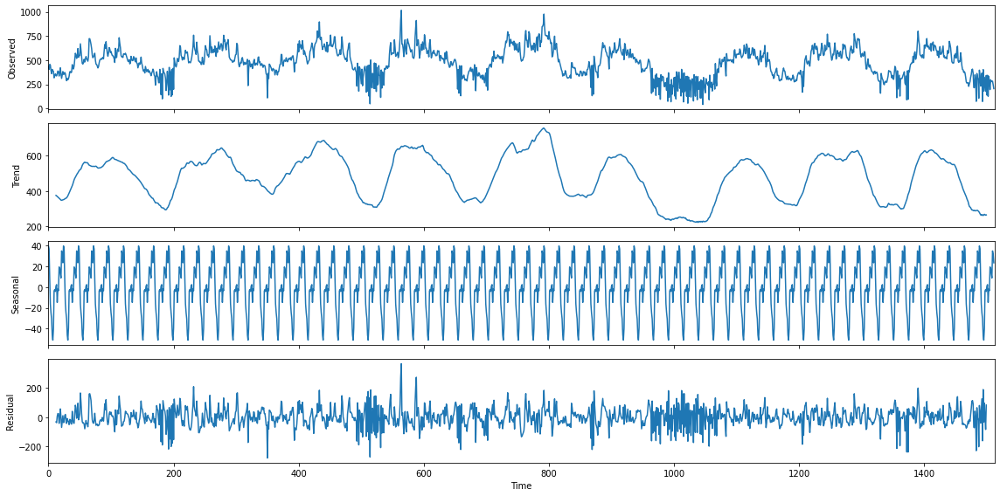

In [19]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure





plt.cla()
plt.close()

from statsmodels.tsa.seasonal import  seasonal_decompose

import matplotlib as mpl
with mpl.rc_context():
    mpl.rc("figure", figsize=(16,8))
    
    analysis = seasonal_decompose(o_df["Mean"][start_pos:start_pos+24*7*weeknum].values,model="additive", freq=24)
    #print(analysis.seasonal)
    analysis.plot()
    plt.show()

## Heti fekvencia ? 24*7 

In [20]:

start_pos = 3118 #@param {type:"slider", min:1000, max:5000, step:1}

weeknum =  12#@param {type:"integer"}

In [21]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure


from statsmodels.tsa.seasonal import  seasonal_decompose

import matplotlib as mpl


In [22]:

start_pos = 1702 #@param {type:"slider", min:1000, max:5000, step:1}

weeknum =  12#@param {type:"integer"}

In [23]:
import plotly.express as px
from plotly.subplots import make_subplots

data1 = seasonal_decompose(o_df["Max"][start_pos:start_pos+24*7*weeknum].values,model="additive", freq=24*7)
  

fig2 = make_subplots(rows=4, cols=1,shared_xaxes=True)
fig2.add_trace(
    go.Scatter(x=o_df.index[start_pos:start_pos+24*7*weeknum], y=data1.resid,name="Residual" ),

    row=1, col=1
)
fig2.add_trace(
    go.Scatter( x=o_df.index[start_pos:start_pos+24*7*weeknum], y=data1.trend,name="Trend"),

    row=2, col=1
)
fig2.add_trace(
    go.Scatter( x=o_df.index[start_pos:start_pos+24*7*weeknum], y=data1.seasonal,name="Seasonal"),

    row=3, col=1
)

fig2.add_trace(
    go.Scatter( x=o_df.index[start_pos:start_pos+24*7*weeknum], y=data1.observed,name="Observed"),

    row=4, col=1
)



fig2.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
  
)

fig2.show()


print(o_df.index[start_pos])

2020-01-31 08:00:00


In [24]:
from statsmodels.tsa.stattools import pacf, acf 
oa,ob=pacf(o_df.Max[:25000], nlags=600, alpha=0.1,)


In [25]:
import plotly.express as px

xl=list(range(len(oa)))
fig = px.line(oa,x=xl, y=oa, title='Nitrogén tömegáram',range_y=(-1,1),)

fig.add_trace(
    go.Scatter(x=xl,
               y=ob[:,1],
               )
    

)
fig.add_trace(
    go.Scatter(x=xl,
               y=ob[:,0],
               )
    

)


fig.show()




The null hypothesis of the test is that there is no serial correlation in the residuals. The Durbin-Watson test statistic is defined as:

∑t=2T((et−et−1)2)/∑t=1Te2t
The test statistic is approximately equal to 2*(1-r) where r is the sample autocorrelation of the residuals. Thus, for r == 0, indicating no serial correlation, the test statistic equals 2. This statistic will always be between 0 and 4. The closer to 0 the statistic, the more evidence for positive serial correlation. The closer to 4, the more evidence for negative serial correlation.

In [26]:
from statsmodels.stats.stattools import durbin_watson
from statsmodels.tsa.stattools import adfuller
o1=durbin_watson(o_df.Min)
print(f"Durbin_Wattson elemzés eredménye: {o1}")
o2=adfuller(o_df.Mean)
print(f"ad_Fuller elemzés eredménye: {o2[1]},  nulla (0) ha nincs tendencia")

Durbin_Wattson elemzés eredménye: 0.02141501761290184
ad_Fuller elemzés eredménye: 0.0,  nulla (0) ha nincs tendencia


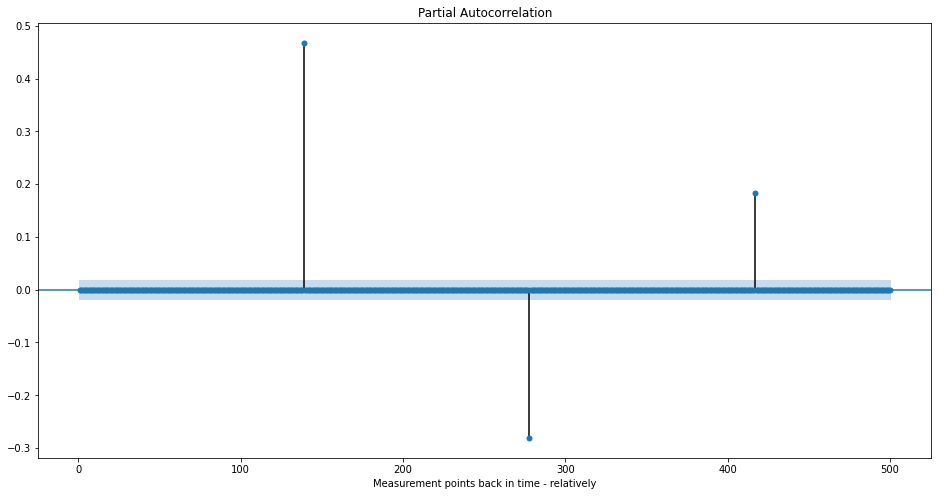

---


In [27]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

fig, ax = plt.subplots(figsize=(16,8))


plot_pacf(o_df.Max[:], lags=500, zero=False, ax=ax)
plt.xlabel("Measurement points back in time - relatively")

plt.show()
print("---")

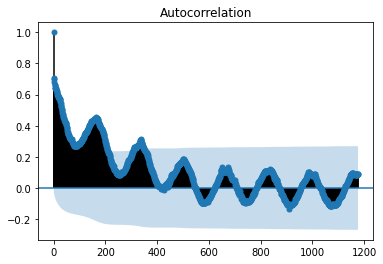

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
dta = o_df.Max[:5000]
dta.index = o_df.index[:5000]


sm.graphics.tsa.plot_acf(dta.values.squeeze(), lags=24*7*7)
plt.show()


In [29]:
#statsmodels.graphics.tsa
o_df

,Max,Min,Mean
timeStamp,,,
2019-11-21 09:00:00,626.10,626.10,626.10
2019-11-21 10:00:00,723.90,492.50,621.43
2019-11-21 11:00:00,769.00,554.50,654.03
2019-11-21 12:00:00,764.60,578.80,685.52
2019-11-21 13:00:00,662.50,500.40,580.33
...,...,...,...
2021-01-22 19:00:00,864.50,737.80,809.58
2021-01-22 20:00:00,882.90,767.70,832.27
2021-01-22 21:00:00,785.60,671.70,736.52


In [30]:
import plotly.express as px
fig = px.histogram(o_df, x=o_df["Max"],log_y=False)
fig.show()

In [31]:
#Outlier detektálás

In [104]:
from sklearn.cluster import DBSCAN
import numpy as np
X = o_df
print(type(X))
clustering = DBSCAN(eps=100, min_samples=1).fit(X)
print(clustering.labels_)



<class 'pandas.core.frame.DataFrame'>
[0 0 0 ... 0 0 0]


### Nézzünk egy histogramot az eloszlásról

In [105]:
import plotly.express as px
df=pd.DataFrame(clustering.labels_)

fig = px.histogram(df,x=df[0])
fig.show()


### Betyárúl néz ki !!

In [106]:
print (o_df.describe())

amax=df.max
o=[index for (index,i) in enumerate(clustering.labels_) if i>0]
print(clustering.labels_[o])
print(o_df.Max[o])


                         Max      Min                  Mean
count               10247.00 10247.00              10247.00
mean      283011054336405.38   444.20     56592529853849.47
std     20652409695535504.00   955.36   4268246866342296.00
min                     0.00     0.00                  0.00
25%                   492.30    88.90                294.65
50%                   573.60   336.90                459.99
75%                   646.80   467.85                566.36
max   1738198828336545792.00  6173.30 386269353275817984.00
[ 1  2  3  4  5  6  7  8  9 10 11 12 13  2 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 

In [35]:
### Találtunk egypár outliert szedjük ki a dataframe-ből

In [36]:
print("Ezek lesznek az Outlierek")
print(o_df.Max[o])
print("\n\nAz eredeti Dataframe:\n",o_df.describe())
o_df_clear=o_df.drop(o_df.index[o])
print("\n\nA végleges Dataframe:\n",o_df_clear.describe())




Ezek lesznek az Outlierek
timeStamp
2019-12-24 10:00:00                   878.80
2020-01-20 12:00:00                  6174.30
2020-08-07 15:00:00   1161735877009866752.00
2020-08-08 12:00:00        26522809270272.00
2020-08-13 15:00:00   1738198828336545792.00
                               ...          
2020-11-19 10:00:00                  6172.30
2020-12-02 09:00:00                  1108.20
2020-12-10 09:00:00                  6156.30
2020-12-11 22:00:00        26522813464576.00
2021-01-15 06:00:00                  1216.00
Name: Max, Length: 279, dtype: float64


Az eredeti Dataframe:
                          Max      Min                  Mean
count               10247.00 10247.00              10247.00
mean      283011054336405.38   444.20     56592529853849.47
std     20652409695535504.00   955.36   4268246866342296.00
min                     0.00     0.00                  0.00
25%                   492.30    88.90                294.65
50%                   573.60   336.90        

### Sikerült kiszedni, nézzünk egy hisztogramot

In [37]:

df=pd.DataFrame(clustering.labels_)

fig = px.histogram(o_df_clear,x="Max",opacity=0.8,nbins=400)
fig.show()


In [38]:
start_pos = 1994 #@param {type:"slider", min:1000, max:5000, step:1}

weeknum =  12#@param {type:"integer"}

In [39]:
import plotly.express as px
from plotly.subplots import make_subplots


data1 = seasonal_decompose(o_df_clear["Max"][start_pos:start_pos+24*7*weeknum].values,model="additive", freq=24*7)
  

fig2 = make_subplots(rows=4, cols=1,shared_xaxes=True)
fig2.add_trace(
    go.Scatter(x=o_df_clear.index[start_pos:start_pos+24*7*weeknum], y=data1.resid,name="Residual" ),

    row=1, col=1
)
fig2.add_trace(
    go.Scatter( x=o_df_clear.index[start_pos:start_pos+24*7*weeknum], y=data1.trend,name="Trend"),

    row=2, col=1
)
fig2.add_trace(
    go.Scatter( x=o_df_clear.index[start_pos:start_pos+24*7*weeknum], y=data1.seasonal,name="Seasonal"),

    row=3, col=1
)

fig2.add_trace(
    go.Scatter( x=o_df_clear.index[start_pos:start_pos+24*7*weeknum], y=data1.observed,name="Observed"),

    row=4, col=1
)



fig2.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
  
)

fig2.show()


print(o_df_clear.index[start_pos])

2020-02-12 14:00:00


In [40]:
from sklearn.model_selection import train_test_split

train_data, test_data = train_test_split(o_df_clear, test_size=0.2, shuffle=False)



In [41]:
def create_train_data(df,selector="Mean", sample=10,test_size=0.2,printout=False):
    '''
    df dataframe selector által meghatározott oszlopából 10 sample méretű idősor tanulóset-et készít
    
    '''
    sample+=1
    X_train=[]
    y_train=[]
    X_test=[]
    y_test=[]
    
    train_data, test_data = train_test_split(df, test_size=test_size, shuffle=False)
    
    for t in range(len(list(train_data[selector]))-sample):
        a=list(train_data[selector][t:t+sample])
    
        #print(a)
        X_train.append(a[0:sample-1])
        #print(a)
        y_train.append([a[-1]])

    for t in range(len(list(test_data[selector]))-sample):
        a=list(test_data[selector][t:t+sample])
        X_test.append(a[0:sample-1])
        y_test.append([a[-1]])

    if printout:
        for i in range(10):
            print(X_train[i], y_train[i])

    return(X_train,y_train,X_test,y_test)



#készítsünk egy tanuló szetet !

In [42]:
sample=10
X_train=[]
y_train=[]
X_test=[]
y_test=[]
X_train,y_train,X_test,y_test=create_train_data(o_df_clear,selector="Mean",sample=sample,test_size=0.2,printout=True)

[626.1, 621.4307692307693, 654.0333333333332, 685.525, 580.3333333333334, 647.4416666666666, 548.2166666666666, 537.475, 539.9499999999999, 586.7166666666668] [629.5416666666666]
[621.4307692307693, 654.0333333333332, 685.525, 580.3333333333334, 647.4416666666666, 548.2166666666666, 537.475, 539.9499999999999, 586.7166666666668, 629.5416666666666] [637.9333333333334]
[654.0333333333332, 685.525, 580.3333333333334, 647.4416666666666, 548.2166666666666, 537.475, 539.9499999999999, 586.7166666666668, 629.5416666666666, 637.9333333333334] [618.1166666666664]
[685.525, 580.3333333333334, 647.4416666666666, 548.2166666666666, 537.475, 539.9499999999999, 586.7166666666668, 629.5416666666666, 637.9333333333334, 618.1166666666664] [631.2166666666668]
[580.3333333333334, 647.4416666666666, 548.2166666666666, 537.475, 539.9499999999999, 586.7166666666668, 629.5416666666666, 637.9333333333334, 618.1166666666664, 631.2166666666668] [550.2833333333332]
[647.4416666666666, 548.2166666666666, 537.475,

### Ez jónak tűnik!!!
Nézzük meg mivel érdemes tanítani!

In [43]:
#!!pip install lazypredict  # Lazypredict egy gyors tesztlehetőséget ad, és semmit sem kell csinálni!!!!

In [44]:
regressor = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=None)
rego=regressor.fit(pd.DataFrame(X_train),pd.DataFrame(X_test),pd.DataFrame(y_train),pd.DataFrame(y_test))

 21%|██▏       | 9/42 [00:04<00:22,  1.44it/s]

GammaRegressor model failed to execute
Some value(s) of y are out of the valid range for family GammaDistribution


100%|██████████| 42/42 [00:57<00:00,  1.36s/it]


In [45]:
print(rego[0][0:-10])

                               Adjusted R-Squared  R-Squared  RMSE  Time Taken
Model                                                                         
GradientBoostingRegressor                    0.92       0.92 60.75        2.86
ExtraTreesRegressor                          0.92       0.92 60.89        2.35
RandomForestRegressor                        0.92       0.92 62.03        7.39
LGBMRegressor                                0.92       0.92 62.41        0.22
MLPRegressor                                 0.92       0.92 62.43        7.19
HistGradientBoostingRegressor                0.92       0.92 63.16        0.54
XGBRegressor                                 0.91       0.91 65.55        1.25
BaggingRegressor                             0.91       0.91 66.93        0.77
HuberRegressor                               0.91       0.91 67.16        0.19
LinearSVR                                    0.91       0.91 67.30        0.03
LassoLarsIC                                  0.90   

### MLP regressor nyert, ezt egy neuralis network alapú cucc, ne ezzel próbáljuk először.
###Legyen pl.: GradientBoostingRegressor


In [46]:
# from sklearn.datasets import make_regression
from sklearn.ensemble import GradientBoostingRegressor
regressor=GradientBoostingRegressor(learning_rate=0.5,n_estimators=3000,verbose=1)
regressor.fit(X_train,y_train)
prediction=regressor.predict(X_test)

      Iter       Train Loss   Remaining Time 
         1       12367.0181            1.45m
         2        6191.2824            1.44m
         3        4450.1309            1.43m
         4        3898.3859            1.43m
         5        3699.4689            1.45m
         6        3614.2446            1.45m
         7        3562.6991            1.46m
         8        3496.4794            1.48m
         9        3479.3372            1.47m
        10        3398.9754            1.47m
        20        3147.5680            1.49m
        30        2947.0599            1.46m
        40        2819.4628            1.44m
        50        2664.9487            1.43m
        60        2548.6035            1.42m
        70        2450.5911            1.42m
        80        2350.4325            1.41m
        90        2244.0240            1.40m
       100        2156.6204            1.40m
       200        1562.3129            1.34m
       300        1122.9556            1.28m
       40

In [47]:
# gyártunk egy X tengelyt a plotly-nak
x_=[i for i in range(-1*sample,len(prediction))]

In [48]:
import plotly.express as px
from plotly.subplots import make_subplots

  

fig2 = make_subplots(rows=1, cols=1,shared_xaxes=True)


fig2.add_trace(
    go.Scatter(x=x_, y=pd.DataFrame(y_test)[0],name="Testvalues" ),

    row=1, col=1
)

fig2.add_trace(
    go.Scatter(x=x_, y=prediction,name="Prediction",fill="none",opacity=0.5),

    row=1, col=1
    
)



fig2.show()


#Mi lenne, ha a minimumot és a maximumot predikálnánk az átlagnak közötte kell lenni!

In [49]:
from sklearn.model_selection import train_test_split
sample=2
testsize=0.05

Mean_X_train,Mean_y_train,Mean_X_test,Mean_y_test=create_train_data(o_df_clear,selector="Mean", sample=sample,test_size=testsize,printout=True)



[626.1, 621.4307692307693] [654.0333333333332]
[621.4307692307693, 654.0333333333332] [685.525]
[654.0333333333332, 685.525] [580.3333333333334]
[685.525, 580.3333333333334] [647.4416666666666]
[580.3333333333334, 647.4416666666666] [548.2166666666666]
[647.4416666666666, 548.2166666666666] [537.475]
[548.2166666666666, 537.475] [539.9499999999999]
[537.475, 539.9499999999999] [586.7166666666668]
[539.9499999999999, 586.7166666666668] [629.5416666666666]
[586.7166666666668, 629.5416666666666] [637.9333333333334]


In [50]:
Min_X_train,Min_y_train,Min_X_test,Min_y_test=create_train_data(o_df_clear,selector="Min",sample=sample,test_size=testsize,printout=True)


[626.1, 492.5] [554.5]
[492.5, 554.5] [578.8]
[554.5, 578.8] [500.4]
[578.8, 500.4] [489.3]
[500.4, 489.3] [445.8]
[489.3, 445.8] [452.6]
[445.8, 452.6] [441.4]
[452.6, 441.4] [442.1]
[441.4, 442.1] [565.6]
[442.1, 565.6] [578.6]


In [51]:
Max_X_train,Max_y_train,Max_X_test,Max_y_test=create_train_data(o_df_clear,selector="Max",sample=sample,test_size=testsize,printout=True)


[626.1, 723.9] [769.0]
[723.9, 769.0] [764.6]
[769.0, 764.6] [662.5]
[764.6, 662.5] [803.1]
[662.5, 803.1] [625.4]
[803.1, 625.4] [625.6]
[625.4, 625.6] [612.5]
[625.6, 612.5] [727.7]
[612.5, 727.7] [705.6]
[727.7, 705.6] [695.7]


In [52]:
# from sklearn.datasets import make_regression
from sklearn.ensemble import GradientBoostingRegressor
maxregressor=GradientBoostingRegressor(learning_rate=0.5,n_estimators=4500,verbose=1)
maxregressor.fit(Max_X_train,Max_y_train)
Max_prediction=maxregressor.predict(Max_X_test)



      Iter       Train Loss   Remaining Time 
         1       13161.0864           50.19s
         2        6493.3059           42.18s
         3        4616.5291           38.59s
         4        4078.4074           36.68s
         5        3908.4260           35.66s
         6        3810.5691           35.13s
         7        3766.7810           34.58s
         8        3723.9493           34.21s
         9        3697.7136           33.98s
        10        3654.7386           34.15s
        20        3426.2347           31.76s
        30        3273.2670           31.63s
        40        3153.5218           31.47s
        50        3073.4769           30.97s
        60        2982.1506           31.17s
        70        2871.2508           31.05s
        80        2752.7122           31.31s
        90        2688.4033           31.13s
       100        2592.8361           31.01s
       200        2042.2607           29.64s
       300        1673.3173           28.65s
       40

In [53]:
# from sklearn.datasets import make_regression
from sklearn.ensemble import GradientBoostingRegressor
minregressor=GradientBoostingRegressor(learning_rate=0.5,n_estimators=4500,verbose=1)
minregressor.fit(Min_X_train,Min_y_train)
Min_prediction=minregressor.predict(Min_X_test)


      Iter       Train Loss   Remaining Time 
         1       17637.9028           33.66s
         2       10231.7425           31.46s
         3        8194.6147           30.61s
         4        7522.9592           29.77s
         5        7309.6659           29.77s
         6        7217.0181           29.47s
         7        7135.8491           29.36s
         8        7116.1800           29.31s
         9        7081.9874           29.02s
        10        7043.5094           28.91s
        20        6763.2084           27.73s
        30        6514.4506           27.23s
        40        6321.4167           27.45s
        50        6208.4340           27.34s
        60        6066.1882           27.27s
        70        5922.6880           27.20s
        80        5794.8337           27.07s
        90        5672.3337           27.02s
       100        5585.8533           26.87s
       200        4819.4298           25.98s
       300        4094.4097           25.20s
       40

In [54]:
minregressor.predict(Min_X_test[0:10])

array([127.03357778,  82.53047647, 133.12651692, 153.55058392,
       131.26197865, 133.49445059, 129.00956828, 153.72804899,
        78.06970818, 122.60454548])

In [55]:
Min_X_test[0:10]

[[127.4, 127.1],
 [127.1, 125.9],
 [125.9, 125.8],
 [125.8, 125.5],
 [125.5, 125.1],
 [125.1, 123.1],
 [123.1, 121.2],
 [121.2, 119.6],
 [119.6, 119.4],
 [119.4, 121.2]]

In [56]:
Max_x_=[i for i in range(1*(sample),len(Max_prediction))]
Min_x_=[i for i in range(1*(sample),len(Min_prediction))]
x_=[i for i in range(-0*(sample),len(Mean_y_test))]

import plotly.express as px
from plotly.subplots import make_subplots

  

fig2 = make_subplots(rows=1, cols=1,shared_xaxes=True)


'''


'''
fig2.add_trace(
    go.Scatter(x=x_, y=pd.DataFrame(Mean_y_test)[0],name="Testvalues" ),

    row=1, col=1
)

fig2.add_trace(
    go.Scatter(x=Max_x_, y=Max_prediction,name="Maxvalues", line=dict(color='rgba(200,0,0,0.1)'),showlegend=False ),

    row=1, col=1
)

fig2.add_trace(
    go.Scatter(x=Min_x_,
               y=Min_prediction,
               name="Minvalues",
               line=dict(color='rgba(200,0,0,0.1)'),
               fillcolor='rgba(0,100,80,0.2)',
               showlegend=False,
               fill='tonexty'
               ),

    row=1, col=1

)


fig2.show()

# Prophet tesz

In [57]:
o_df.head()

,Max,Min,Mean
timeStamp,,,
2019-11-21 09:00:00,626.10,626.10,626.10
2019-11-21 10:00:00,723.90,492.50,621.43
2019-11-21 11:00:00,769.00,554.50,654.03
2019-11-21 12:00:00,764.60,578.80,685.52
2019-11-21 13:00:00,662.50,500.40,580.33


In [58]:
pro_df=pd.DataFrame(data={"ds":o_df.index,"y":o_df.Mean})

In [59]:
pro_df.head()

,ds,y
timeStamp,,
2019-11-21 09:00:00,2019-11-21 09:00:00,626.10
2019-11-21 10:00:00,2019-11-21 10:00:00,621.43
2019-11-21 11:00:00,2019-11-21 11:00:00,654.03
2019-11-21 12:00:00,2019-11-21 12:00:00,685.52
2019-11-21 13:00:00,2019-11-21 13:00:00,580.33


In [60]:
# van az adathalmazban adathiba kivesszük!
for i in pro_df.index:
    if pro_df.loc[i,"y"]>1600:
        #print(i,df_korr.loc[i,"PSA_M"])
        pro_df.drop(index=i,inplace=True)

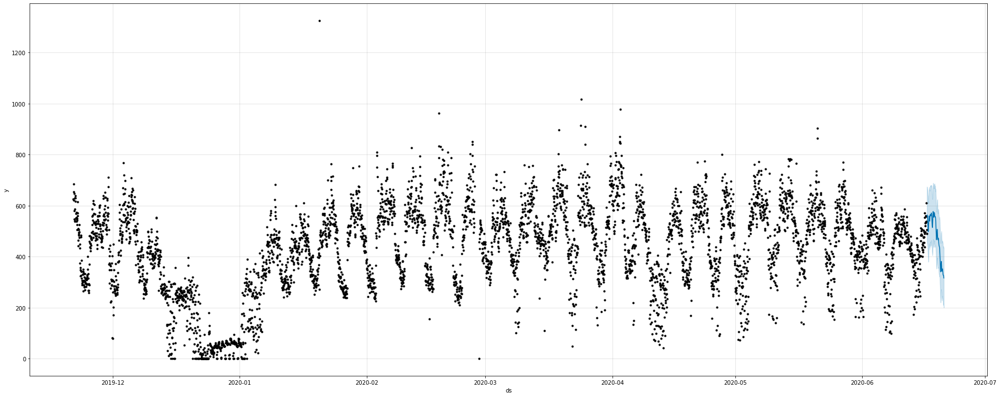

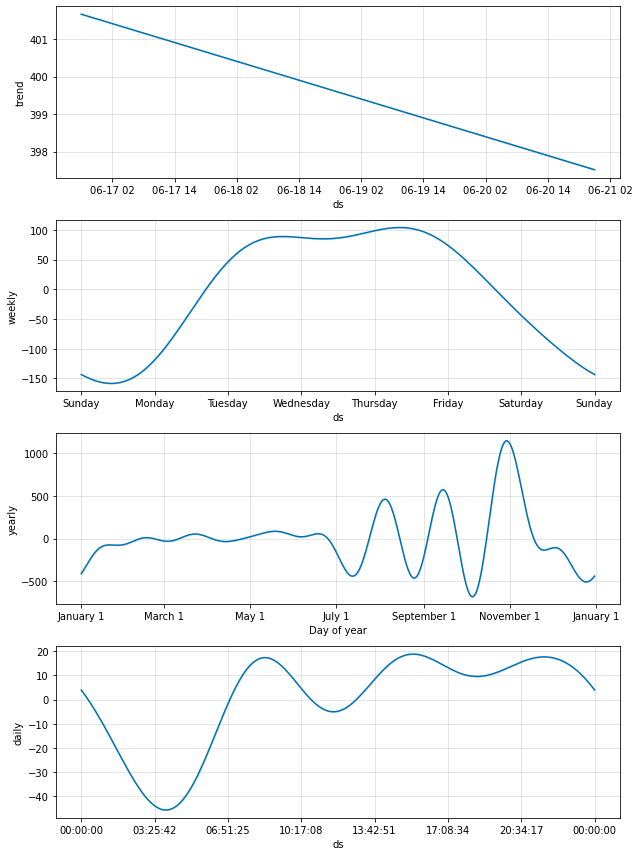

In [61]:

from fbprophet import Prophet
m = Prophet(yearly_seasonality=True)
m.fit(pro_df[:-5000])
forecast = m.predict(pro_df[-5000:-4900],)

profet_graf=m.plot(forecast,figsize=(25,10),)
m.plot_components(forecast);


In [62]:
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-06-16 20:00:00,401.66,462.28,674.42,401.66,401.66,158.35,158.35,158.35,13.32,13.32,13.32,88.76,88.76,88.76,56.26,56.26,56.26,0.00,0.00,0.00,560.01
1,2020-06-16 21:00:00,401.62,452.70,673.13,401.62,401.62,161.59,161.59,161.59,16.80,16.80,16.80,88.46,88.46,88.46,56.33,56.33,56.33,0.00,0.00,0.00,563.21
2,2020-06-16 22:00:00,401.58,450.68,666.23,401.58,401.58,161.82,161.82,161.82,17.34,17.34,17.34,88.09,88.09,88.09,56.39,56.39,56.39,0.00,0.00,0.00,563.40
3,2020-06-16 23:00:00,401.54,449.62,662.59,401.54,401.54,157.34,157.34,157.34,13.22,13.22,13.22,87.67,87.67,87.67,56.45,56.45,56.45,0.00,0.00,0.00,558.88
4,2020-06-17 00:00:00,401.49,438.74,660.72,401.49,401.49,147.72,147.72,147.72,3.98,3.98,3.98,87.23,87.23,87.23,56.51,56.51,56.51,0.00,0.00,0.00,549.21


In [63]:
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-06-16 20:00:00,401.66,462.28,674.42,401.66,401.66,158.35,158.35,158.35,13.32,13.32,13.32,88.76,88.76,88.76,56.26,56.26,56.26,0.00,0.00,0.00,560.01
1,2020-06-16 21:00:00,401.62,452.70,673.13,401.62,401.62,161.59,161.59,161.59,16.80,16.80,16.80,88.46,88.46,88.46,56.33,56.33,56.33,0.00,0.00,0.00,563.21
2,2020-06-16 22:00:00,401.58,450.68,666.23,401.58,401.58,161.82,161.82,161.82,17.34,17.34,17.34,88.09,88.09,88.09,56.39,56.39,56.39,0.00,0.00,0.00,563.40
3,2020-06-16 23:00:00,401.54,449.62,662.59,401.54,401.54,157.34,157.34,157.34,13.22,13.22,13.22,87.67,87.67,87.67,56.45,56.45,56.45,0.00,0.00,0.00,558.88
4,2020-06-17 00:00:00,401.49,438.74,660.72,401.49,401.49,147.72,147.72,147.72,3.98,3.98,3.98,87.23,87.23,87.23,56.51,56.51,56.51,0.00,0.00,0.00,549.21


In [64]:

# Python
from fbprophet.plot import plot_plotly, plot_components_plotly
import plotly.graph_objects as go
from plotly import tools
import plotly.express as px
import pandas as pd

fbfig=plot_plotly(m, forecast)


fbfig.update_layout(
    autosize=False,
    width=1600,
    height=900,
    
    )

fbfig.add_trace(
    go.Scatter(x=pro_df[-5000:-4900].ds, y=pro_df[-5000:-4900].y,
            name="Test data",
            showlegend=True,
            mode="markers",
            marker=dict(color='rgba(200,0,0,0.9)', 
            symbol="diamond")   ),
 
   
    


)


fbfig.show()

#**Ide még lehetne egy kis prophet tesztet beiktatni, vajon mit mutat a pillanatnyi adatokra?**



---

---





In [65]:
import plotly.express as px
import numpy as np
import pandas as pd
import plotly.graph_objects as go

In [66]:
df=pd.read_csv("/content/all.csv")
print(df.info())
print(df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 122423 entries, 0 to 122422
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   timeStamp  122423 non-null  object 
 1   LIN_V      122423 non-null  float64
 2   LIN_P      122423 non-null  float64
 3   PSA_M      122423 non-null  float64
 4   PSA_P      122423 non-null  float64
 5   PSA_Q      122423 non-null  float64
dtypes: float64(5), object(1)
memory usage: 5.6+ MB
None
                  timeStamp    LIN_V  LIN_P  PSA_M  PSA_P  PSA_Q
0       2019-11-21 09:58:15 32356.38   9.00 626.10   7.60   0.27
1       2019-11-21 10:03:16 32346.85   9.00 663.10   7.70   0.28
2       2019-11-21 10:03:21 32347.00   8.59 663.10   7.70   0.28
3       2019-11-21 10:08:22 32350.00   8.61 548.90   7.70   0.27
4       2019-11-21 10:13:21 32327.00   8.62 492.50   7.70   0.27
...                     ...      ...    ...    ...    ...    ...
122418  2021-01-22 23:31:50 22143.00   8.41 593.70

In [67]:
df_fb=pd.DataFrame(data={"ds":df.timeStamp,"y":df.PSA_M})
df_fb.head()

,ds,y
0,2019-11-21 09:58:15,626.10
1,2019-11-21 10:03:16,663.10
2,2019-11-21 10:03:21,663.10
3,2019-11-21 10:08:22,548.90
4,2019-11-21 10:13:21,492.50


In [68]:


print(f"{df_fb['y'].isnull().sum()} db NAN van a DF-ben" )

db=0
for i in df_fb.index:
    if df_fb.loc[i,"y"]>1500:
        #print(i,df_korr.loc[i,"PSA_M"])
        db+=1
        if db%100==0:
            print(f"{db}..", end="")
        df_fb.drop(index=i,inplace=True)

print(f"\nMűszaki határokon kívül eső {db}. db elem törölve!")

0 db NAN van a DF-ben
100..200..300..400..500..600..700..800..900..1000..1100..1200..1300..1400..1500..1600..1700..1800..1900..2000..2100..2200..2300..2400..2500..2600..2700..2800..2900..3000..3100..
Műszaki határokon kívül eső 3199. db elem törölve!


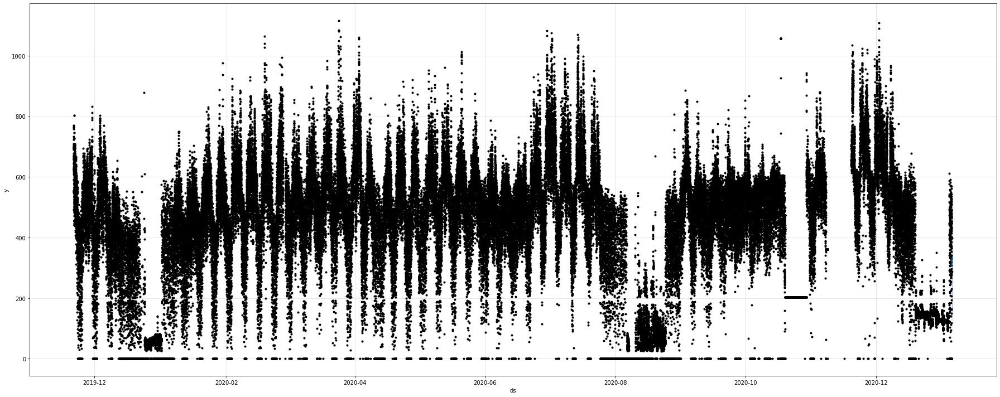

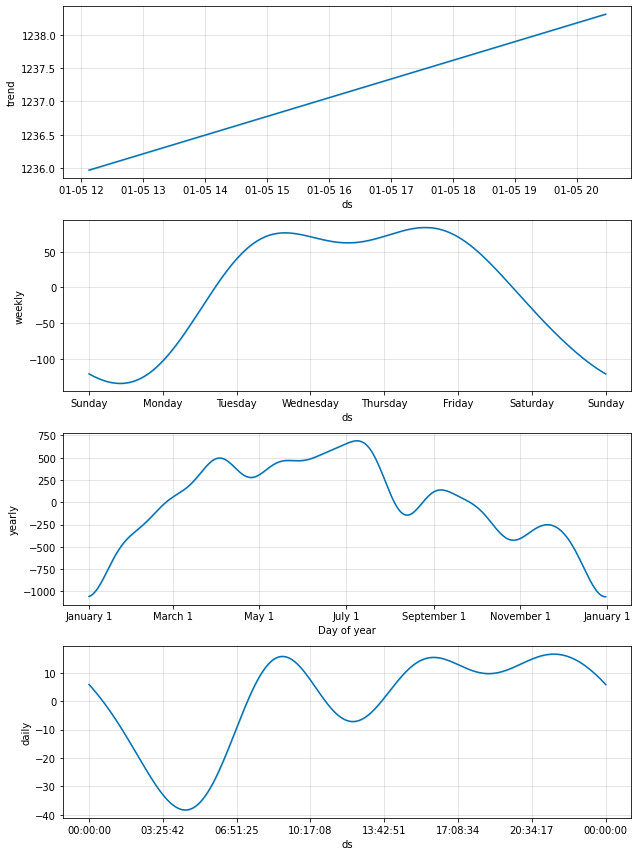

In [69]:




from fbprophet import Prophet
m = Prophet(yearly_seasonality=True)
m.fit(df_fb[:-5000])
forecast = m.predict(df_fb[-5000:-4900],)

profet_graf=m.plot(forecast,figsize=(25,10),)
m.plot_components(forecast);




In [70]:
# Python
from fbprophet.plot import plot_plotly, plot_components_plotly
import plotly.graph_objects as go
from plotly import tools
import plotly.express as px
import pandas as pd

fbfig=plot_plotly(m, forecast)


fbfig.update_layout(
    autosize=False,
    width=1600,
    height=900,
    
    )

fbfig.add_trace(
    go.Scatter(x=df_fb[-5000:-4900].ds, y=df_fb[-5000:-4900].y,
            name="Test data",
            showlegend=True,
            mode="markers",
            marker=dict(color='rgba(200,0,0,0.9)', 
            symbol="diamond")   ),
 
   
    


)


fbfig.show()



---

---





#Regresszió, korreláció keresés

Kérdés: Lehet e pótolni a hiányzó adatoka a többi adat ismeretében?

In [71]:
# importáljunk, akkor ez a rész függetlenül is tud működni!
import plotly.express as px
import numpy as np
import pandas as pd
import plotly.graph_objects as go

In [72]:
# Beolvassuk ismét az adatsort

!rm /content/all.csv
!wget "https://github.com/sipocz/messer/raw/main/all.csv"
!head /content/all.csv


--2021-02-23 19:08:20--  https://github.com/sipocz/messer/raw/main/all.csv
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/sipocz/messer/main/all.csv [following]
--2021-02-23 19:08:20--  https://raw.githubusercontent.com/sipocz/messer/main/all.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6249032 (6.0M) [text/plain]
Saving to: ‘all.csv’

all.csv             100%[===================>]   5.96M  20.8MB/s    in 0.3s    

2021-02-23 19:08:21 (20.8 MB/s) - ‘all.csv’ saved [6249032/6249032]

timeStamp,LIN_V,LIN_P,PSA_M,PSA_P,PSA_Q
2019-11-21 09:58:15,32356.38,9.0,626.1,7.6,0.2749
2019-11-21 1

In [73]:
df_korr=pd.read_csv("/content/all.csv")

In [74]:
df_korr.head()

,timeStamp,LIN_V,LIN_P,PSA_M,PSA_P,PSA_Q
0,2019-11-21 09:58:15,32356.38,9.00,626.10,7.60,0.27
1,2019-11-21 10:03:16,32346.85,9.00,663.10,7.70,0.28
2,2019-11-21 10:03:21,32347.00,8.59,663.10,7.70,0.28
3,2019-11-21 10:08:22,32350.00,8.61,548.90,7.70,0.27
4,2019-11-21 10:13:21,32327.00,8.62,492.50,7.70,0.27


In [75]:


fig = px.histogram(df_korr,x="LIN_P",opacity=0.8,nbins=400)
fig.show()


In [76]:
#outlier detection

In [77]:
from sklearn.cluster import DBSCAN

X=list(df_korr.PSA_M)
X=np.reshape(X, (-1, 1))

dbscan=DBSCAN(eps=5.5, min_samples=60)

dbscan.fit(X)

DBSCAN(eps=5.5, min_samples=60)

In [78]:
labels=dbscan.labels_
print(labels)

[0 0 0 ... 0 0 0]


In [79]:
outliers=[1 if i==-1 else 0  for i in labels]
inliers= [1 if i!=-1 else 0  for i in labels]
#print(outliers)
fig = px.scatter(df_korr,x=df_korr.index,y=df_korr["PSA_M"],opacity=0.8, title="PSA tömegáram [Nm3/h] nyers adatokkal ")
fig.show()
df_om=df_korr
## Kiszedjük azokat az elemeket, ahol műszaki határokat átlépve kaptunk adatokat
for i in df_om.index:
    if df_om.loc[i,"PSA_M"]>1500:
        #print(i,df_korr.loc[i,"PSA_M"])
        df_om.drop(index=i,inplace=True)

In [80]:
fig = px.scatter(df_korr,x=df_om.index,y=df_om["PSA_P"],opacity=0.8,title="PSA nyomásértékek [Bar], nyers adatok")

fig.show()


In [81]:
## Kiszedjük azokat az elemeket, ahol műszaki határokat átlépve kaptunk adatokat ha áll a berendezés nem lesz nyomása
for i in df_om.index:
    if df_om.loc[i,"PSA_P"]<1:
        #print(i,df_korr.loc[i,"PSA_M"])
        df_om.drop(index=i,inplace=True)

In [82]:
# nézzük mit csináltunk!!


In [83]:
fig = px.scatter(df_om,x=df_om.index,y=df_om["PSA_P"],opacity=0.8,title="PSA nyomásértékek [Bar], korrekció után")

fig.show()


In [84]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go



fig2 = make_subplots(rows=1, cols=1,shared_xaxes=True)
fig2.add_trace(
    go.Histogram(x=df_om["PSA_P"],name="OM",nbinsx=40,),

    row=1, col=1
)
fig2.add_trace(
    go.Histogram(x=df_korr["PSA_P"],name="O", nbinsx=40 ),

    row=1, col=1
)





fig2.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
  
)

fig2.show()






In [85]:
print("Amivel foglalkoznunk kell:  ",df_om.columns)

Amivel foglalkoznunk kell:   Index(['timeStamp', 'LIN_V', 'LIN_P', 'PSA_M', 'PSA_P', 'PSA_Q'], dtype='object')


In [86]:
fig = px.scatter(df_korr,x=df_om.index,y=df_om["PSA_Q"],opacity=0.8,title="A rendszerből kilépő Nitrogén maradó Oxigén koncentrációja [%]")

fig.show()

In [87]:
fig = px.scatter(df_om,x=df_om.index,y=df_om["LIN_V"],opacity=0.8, title="Folyékony Nitrogén tartály szintje [Nm3]")

fig.show()

In [88]:
fig = px.scatter(df_om,x=df_om.index,y=df_om["LIN_P"],opacity=0.5,title="Folyékony nitrogén tartály nyomása [Bar]")

fig.show()

In [89]:
#Nézzünk egy korrelációs mátrixot

In [90]:
corr_mat=df_om.corr()
print(corr_mat)

       LIN_V  LIN_P  PSA_M  PSA_P  PSA_Q
LIN_V   1.00   0.33   0.01   0.37  -0.39
LIN_P   0.33   1.00  -0.29   0.68  -0.40
PSA_M   0.01  -0.29   1.00  -0.28  -0.38
PSA_P   0.37   0.68  -0.28   1.00  -0.47
PSA_Q  -0.39  -0.40  -0.38  -0.47   1.00


In [91]:

fig = go.Figure(data=go.Heatmap(
                    z=corr_mat,
                    x=corr_mat.columns,
                    y=corr_mat.columns,
                    colorscale=[[0,'white'], [1,'red']]
                   )
)

fig.update_layout(
    autosize=False,
    width=500,
    height=500,)
fig.show()

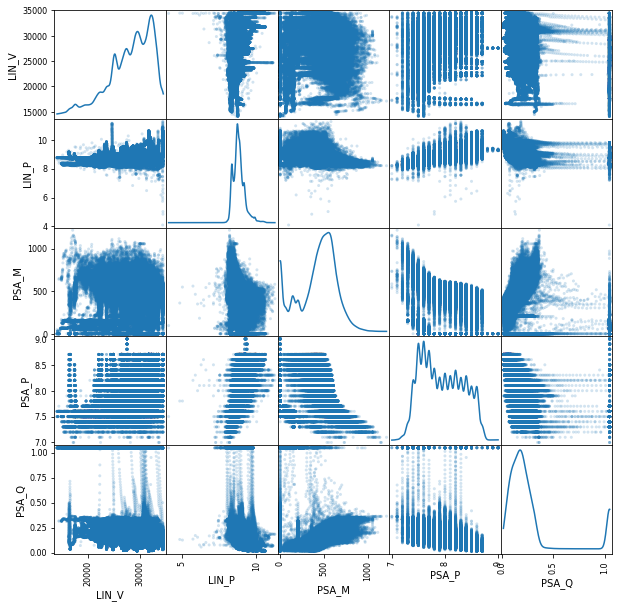

In [92]:
# Készítsünk egy scatter plotot!
from pandas.plotting import scatter_matrix

scatter_matrix(df_om, alpha = 0.2, figsize = (10, 10), diagonal = 'kde');

In [93]:
prediktorok=["LIN_V","LIN_P","PSA_P","PSA_Q"]
from sklearn.linear_model import Lasso
alpha=0.01
lassoreg = Lasso(alpha=alpha,normalize=True, max_iter=1e5)
lassoreg.fit(df_om[prediktorok],df_om[["PSA_M"]])
y_pred = lassoreg.predict(df_om[prediktorok])


In [94]:
x_=[i for i in range(len(y_pred))]

import plotly.express as px
from plotly.subplots import make_subplots

  

fig2 = make_subplots(rows=2, cols=1,shared_xaxes=True,)


'''


'''
fig2.add_trace(
    go.Scatter(x=x_, y=y_pred,name="Predikált érték [Nm3/h]" ),

    row=1, col=1
)

fig2.add_trace(
    go.Scatter(x=x_, y=list(df_om["PSA_M"]),name="Mért érték [Nm3/h]", line=dict(color='rgba(200,0,0,0.2)') ,showlegend=True  ),

    row=1, col=1
)

fig2.add_trace(
    go.Scatter(x=x_, y=list(df_om["LIN_V"]),name="LIN tartály tartalma [Nm3]", line=dict(color='rgba(200,100,1000,0.7)') ,showlegend=True  ),

    row=2, col=1,
    
)



fig2.update_layout(
    autosize=False,
    width=1600,
    height=900,
    )

fig2.update_layout(title="A negatív predikált értékek nyilvánvalóan fizikai képtelenségek, azonban érdemes lenne vizsgálni az okokat.")



fig2.show()

A negatív predikált értékek nyilvánvalóan fizikai képtelenségek, azonban érdemes lenne vizsgálni az okokat. A LIN tartály folyékony nitrogénnel való töltése formálisan ellentétes irányú áramlásnak is felfogható. A LIN tartály szintváltozása a 2. grafikonon!! 



---

---





# Kezdjük újra, TensorFlow!!

In [2]:
#Nitrogén predikció
!rm /content/all.csv
!wget "https://github.com/sipocz/messer/raw/main/all.csv"
!head /content/all.csv

--2021-02-25 10:27:29--  https://github.com/sipocz/messer/raw/main/all.csv
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/sipocz/messer/main/all.csv [following]
--2021-02-25 10:27:29--  https://raw.githubusercontent.com/sipocz/messer/main/all.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6249032 (6.0M) [text/plain]
Saving to: ‘all.csv’

all.csv             100%[===================>]   5.96M  25.2MB/s    in 0.2s    

2021-02-25 10:27:30 (25.2 MB/s) - ‘all.csv’ saved [6249032/6249032]

timeStamp,LIN_V,LIN_P,PSA_M,PSA_P,PSA_Q
2019-11-21 09:58:15,32356.38,9.0,626.1,7.6,0.2749
2019-11-21 10:03

In [4]:
import numpy as np
import pandas as pd
import plotly.express as px

import plotly.graph_objects as go


In [5]:
_PCVERSION_=False
_GITHUB_ORIG=True

if _PCVERSION_:
    basedir="C:/Users/sipocz/OneDrive/Dokumentumok/GitHub/nitrogen"
else:

    if _GITHUB_ORIG:
        basedir="/content/"
    else:
        from google.colab import drive
        drive.mount('/content/drive',force_remount=True)
        basedir="/content/drive/My Drive/001_AI/messer/nitrogen/"
print(basedir)  


/content/


In [6]:
df=pd.read_csv(basedir+"all.csv")
df.head()

,timeStamp,LIN_V,LIN_P,PSA_M,PSA_P,PSA_Q
0,2019-11-21 09:58:15,32356.38,9.00,626.1,7.6,0.2749
1,2019-11-21 10:03:16,32346.85,9.00,663.1,7.7,0.2761
2,2019-11-21 10:03:21,32347.00,8.59,663.1,7.7,0.2761
3,2019-11-21 10:08:22,32350.00,8.61,548.9,7.7,0.2737
4,2019-11-21 10:13:21,32327.00,8.62,492.5,7.7,0.2694


In [7]:
df["timeStamp"]=pd.to_datetime(df["timeStamp"],format="%Y.%m.%d %H:%M:%S")   # konvertáljuk az időbélyeget


d=df[["timeStamp","PSA_M"]]
d.set_index("timeStamp",inplace=True)

In [8]:
agg_10m = d.groupby([pd.Grouper(freq='D')])
resample_mean =  d.resample("60min").agg({'PSA_M': 'mean'})  # újramintázzuk a jeleket, pl órás átlagokkal számoljunk
resample_max =  d.resample("60min").agg({'PSA_M': 'max'})    # újramintázzuk a jeleket, pl órás maximumok
resample_min =  d.resample("60min").agg({'PSA_M': 'min'})    # újramintázzuk a jeleket, pl órás minimumok
o_df=pd.DataFrame({"Max":resample_max.PSA_M,"Min":resample_min.PSA_M, "Mean":resample_mean.PSA_M})


In [10]:
print(f"{o_df['Min'].isnull().sum()} db NAN van a DF-ben" )
o_df.dropna(inplace=True)
print(f"{o_df['Min'].isnull().sum()} db NAN van a DF-ben" )


40 db NAN van a DF-ben
0 db NAN van a DF-ben


In [11]:
from sklearn.cluster import DBSCAN
import numpy as np
X = o_df
print(type(X))
clustering = DBSCAN(eps=100, min_samples=1).fit(X)
print(clustering.labels_)


<class 'pandas.core.frame.DataFrame'>
[0 0 0 ... 0 0 0]


In [14]:
print (o_df.describe())

amax=df.max
o=[index for (index,i) in enumerate(clustering.labels_) if i>0]
print(clustering.labels_[o])
print(o_df.Max[o])


                Max           Min          Mean
count  1.024700e+04  10247.000000  1.024700e+04
mean   2.830111e+14    444.198565  5.659253e+13
std    2.065241e+16    955.360935  4.268247e+15
min    0.000000e+00      0.000000  0.000000e+00
25%    4.923000e+02     88.900000  2.946458e+02
50%    5.736000e+02    336.900000  4.599917e+02
75%    6.468000e+02    467.850000  5.663583e+02
max    1.738199e+18   6173.300000  3.862694e+17
[ 1  2  3  4  5  6  7  8  9 10 11 12 13  2 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14

In [15]:
print("Ezek lesznek az Outlierek")
print(o_df.Max[o])
print("\n\nAz eredeti Dataframe:\n",o_df.describe())
o_df_clear=o_df.drop(o_df.index[o])
print("\n\nA végleges Dataframe:\n",o_df_clear.describe())



Ezek lesznek az Outlierek
timeStamp
2019-12-24 10:00:00    8.788000e+02
2020-01-20 12:00:00    6.174300e+03
2020-05-13 01:00:00    9.618000e+02
2020-08-07 15:00:00    1.161736e+18
2020-08-08 12:00:00    2.652281e+13
                           ...     
2020-11-30 08:00:00    9.673000e+02
2020-12-02 09:00:00    1.108200e+03
2020-12-10 09:00:00    6.156300e+03
2020-12-11 22:00:00    2.652281e+13
2021-01-15 06:00:00    1.216000e+03
Name: Max, Length: 287, dtype: float64


Az eredeti Dataframe:
                 Max           Min          Mean
count  1.024700e+04  10247.000000  1.024700e+04
mean   2.830111e+14    444.198565  5.659253e+13
std    2.065241e+16    955.360935  4.268247e+15
min    0.000000e+00      0.000000  0.000000e+00
25%    4.923000e+02     88.900000  2.946458e+02
50%    5.736000e+02    336.900000  4.599917e+02
75%    6.468000e+02    467.850000  5.663583e+02
max    1.738199e+18   6173.300000  3.862694e+17


A végleges Dataframe:
                Max          Min         Mean
co

In [16]:

df=pd.DataFrame(clustering.labels_)

fig = px.histogram(o_df_clear,x="Max",opacity=0.8,nbins=400)
fig.show()


In [18]:
def create_train_data(df,selector="Mean", sample=10,test_size=0.2,printout=False,scale=False):
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import MinMaxScaler
    '''
    df dataframe selector által meghatározott oszlopából 10 sample méretű idősor tanulóset-et készít
    
    '''
    sample+=1
    X_train=[]
    y_train=[]
    X_test=[]
    y_test=[]
    
    

    train_data, test_data = train_test_split(df, test_size=test_size, shuffle=False)
    
    for t in range(len(list(train_data[selector]))-sample):
        a=list(train_data[selector][t:t+sample])
    
        #print(a)
        X_train.append(a[0:sample-1])
        #print(a)
        y_train.append([a[-1]])

    for t in range(len(list(test_data[selector]))-sample):
        a=list(test_data[selector][t:t+sample])
        X_test.append(a[0:sample-1])
        y_test.append([a[-1]])

    if printout:
        for i in range(10):
            print(X_train[i], y_train[i])

    return(X_train,y_train,X_test,y_test)


In [130]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
sample=5
testsize=0.1
scaler = MinMaxScaler(feature_range=(-1,1))
scaler.fit(o_df_clear)
o_df_clear2=scaler.transform(o_df_clear)
o_df_norm=pd.DataFrame(data=o_df_clear2,columns=["Min","Max","Mean"])

Mean_X_train,Mean_y_train,Mean_X_test,Mean_y_test=create_train_data(o_df_norm, selector="Mean", sample=sample,test_size=testsize,printout=True)



[0.2058549738387958, 0.19686213699631394, 0.2596539659101851, 0.32030623053959495, 0.11770936988412051] [0.24695855936827926]
[0.19686213699631394, 0.2596539659101851, 0.32030623053959495, 0.11770936988412051, 0.24695855936827926] [0.05585336885693182]
[0.2596539659101851, 0.32030623053959495, 0.11770936988412051, 0.24695855936827926, 0.05585336885693182] [0.03516515263377551]
[0.32030623053959495, 0.11770936988412051, 0.24695855936827926, 0.05585336885693182, 0.03516515263377551] [0.039931948768978875]
[0.11770936988412051, 0.24695855936827926, 0.05585336885693182, 0.03516515263377551, 0.039931948768978875] [0.13000353096010064]
[0.24695855936827926, 0.05585336885693182, 0.03516515263377551, 0.039931948768978875, 0.13000353096010064] [0.21248354893589716]
[0.05585336885693182, 0.03516515263377551, 0.039931948768978875, 0.13000353096010064, 0.21248354893589716] [0.22864571630340613]
[0.03516515263377551, 0.039931948768978875, 0.13000353096010064, 0.21248354893589716, 0.2286457163034061

In [131]:
o_df_norm

,Min,Max,Mean
0,0.121942,0.339538,0.205855
1,0.297196,0.053701,0.196862
2,0.378013,0.186350,0.259654
3,0.370128,0.238340,0.320306
4,0.187170,0.070603,0.117709
...,...,...,...
9955,0.549144,0.578519,0.559240
9956,0.582116,0.642490,0.602944
9957,0.407759,0.437099,0.418531
9958,0.279814,0.167950,0.237200


In [183]:
from keras.layers import InputLayer, Dense, LSTM, Input, Dropout
from keras.models import Sequential, Model
from keras.optimizers import SGD,Adam,Adamax




input_size=5
drop_frac=0.8
input1=Input(shape=(input_size,))
l1_out=Dense(370,activation="sigmoid")(input1)
l2_out=Dropout(drop_frac)(l1_out)
pred=Dense(1,)(l2_out)

model = Model(inputs=input1, outputs=pred)
optimizer=Adamax(learning_rate=0.0001) #SGD(lr=0.005, decay=1e-4, momentum=0.9)
model.compile(loss='mean_squared_error',
    optimizer=optimizer,
    metrics=["mse"])


In [ ]:
history = model.fit(Mean_X_train, Mean_y_train, epochs=100, batch_size=1, validation_data=(Mean_X_test, Mean_y_test),)
ypred = model.predict(Mean_X_test)

Epoch 1/100
8958/8958 [==============================] - 10s 1ms/step - loss: 2.1942 - mse: 2.1942 - val_loss: 0.1380 - val_mse: 0.1380
Epoch 2/100
8958/8958 [==============================] - 9s 1ms/step - loss: 1.6331 - mse: 1.6331 - val_loss: 0.0910 - val_mse: 0.0910
Epoch 3/100
8958/8958 [==============================] - 9s 1ms/step - loss: 1.2598 - mse: 1.2598 - val_loss: 0.0792 - val_mse: 0.0792
Epoch 4/100
8958/8958 [==============================] - 9s 1ms/step - loss: 0.9480 - mse: 0.9480 - val_loss: 0.0636 - val_mse: 0.0636
Epoch 5/100
8958/8958 [==============================] - 9s 1ms/step - loss: 0.6827 - mse: 0.6827 - val_loss: 0.0537 - val_mse: 0.0537
Epoch 6/100
8958/8958 [==============================] - 9s 1ms/step - loss: 0.4615 - mse: 0.4615 - val_loss: 0.0608 - val_mse: 0.0608
Epoch 7/100
8958/8958 [==============================] - 10s 1ms/step - loss: 0.3149 - mse: 0.3149 - val_loss: 0.0626 - val_mse: 0.0626
Epoch 8/100
8958/8958 [==============================

In [182]:
y_pred = model.predict(Mean_X_test)
y_pred=y_pred.reshape(-1,)
y_test=[i[0] for i in Mean_y_test]

In [180]:
x_=[i for i in range(len(y_pred))]

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig0 = make_subplots(rows=1, cols=1,)
fig0.add_trace(
    go.Scatter(x=x_, y=list(y_pred), name="Predikált érték [Nm3/h]",line=dict(color='rgba(0,200,0,0.8)') ,showlegend=True  ),

    row=1, col=1

)
fig0.add_trace(
    go.Scatter(x=x_, y=list(y_test), name="Mért érték [Nm3/h]", line=dict(color='rgba(200,0,0,0.3)') ,showlegend=True  ),

    row=1, col=1
)
fig0.update_layout(
    autosize=False,
    width=1200,
    height=600,
    )

fig0.show()